### Import all the packages

In [149]:
import pandas as pd
import nltk
import numpy as np
from numpy import random as npr
import time
import string
import sklearn
import random
# from itertools import chain, imap

In [150]:
from sklearn import metrics
from sklearn.metrics import auc
import matplotlib.pyplot as plt
from sklearn.decomposition import NMF
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import plot_precision_recall_curve


In [151]:
# download stopwords and punctuations 
nltk.download('punkt') 
nltk.download("stopwords")

[nltk_data] Downloading package punkt to /Users/dhmjoe/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/dhmjoe/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [152]:

from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score
import re
from sklearn import svm
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.model_selection import GridSearchCV
#from operator import itemgetter

In [153]:
from collections import Counter
from sklearn.datasets import make_classification
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler

### Data Processing

In [154]:
#Read in data
df1 = pd.read_json('/Users/dhmjoe/Desktop/carpe data Haoming/final_50k_221118.json',lines=True)

In [155]:
df_shuffled = df1.sample(frac=1, random_state=39)

# Reset the index
df_shuffled = df_shuffled.reset_index(drop=True)

# Select first 30000 rows from the shuffled data set
df_30 = df_shuffled[0:100000]

# Regroup the df_30 dat set with unique business id
df_new = df_30.groupby(df_30["awesome_biz_id"],as_index=False).agg({"content":' '.join,"business_name":"first","is_entertainment":"first","is_traffic":"first"})

# Define the label
label = ["is_entertainment","is_traffic"]

# Extract the labels
labeldf = df_new[["is_entertainment","is_traffic"]]

# Extract "business name" and "content" columns
df2 = df_new[["business_name","content"]]


### Test on resample data (is traffic)

In [156]:
labeldf[labeldf[label[1]]==1]


,is_entertainment,is_traffic
0,False,True
1,False,True
2,True,True
3,False,True
4,True,True
...,...,...
27934,False,True
27935,False,True
27936,False,True
27937,False,True


In [157]:
labeldf[labeldf[label[1]]==0]

,is_entertainment,is_traffic
27939,False,False
27940,False,False
27941,False,False
27942,True,False
27943,False,False
...,...,...
34339,False,False
34340,False,False
34341,True,False
34342,False,False


In [158]:
oversample = RandomOverSampler(sampling_strategy=0.5)
x_over,y_over = oversample.fit_resample(df2,labeldf[label[1]])
y_over[y_over==1]

0        True
1        True
2        True
3        True
4        True
         ... 
27934    True
27935    True
27936    True
27937    True
27938    True
Name: is_traffic, Length: 27939, dtype: bool

In [159]:
y_over[y_over==0]

27939    False
27940    False
27941    False
27942    False
27943    False
         ...  
41903    False
41904    False
41905    False
41906    False
41907    False
Name: is_traffic, Length: 13969, dtype: bool

In [160]:
undersample = RandomUnderSampler(sampling_strategy=1)
x_over,y_over = undersample.fit_resample(x_over,y_over)
y_over[y_over==1]

13969    True
13970    True
13971    True
13972    True
13973    True
         ... 
27933    True
27934    True
27935    True
27936    True
27937    True
Name: is_traffic, Length: 13969, dtype: bool

In [161]:
y_over[y_over==0]

0        False
1        False
2        False
3        False
4        False
         ...  
13964    False
13965    False
13966    False
13967    False
13968    False
Name: is_traffic, Length: 13969, dtype: bool

### Test on resample data (is entertainment)

In [162]:
labeldf[labeldf[label[0]]==1]


,is_entertainment,is_traffic
2,True,True
4,True,True
22,True,True
24,True,True
25,True,True
...,...,...
34333,True,False
34336,True,False
34338,True,False
34341,True,False


In [163]:
labeldf[labeldf[label[0]]==0]


,is_entertainment,is_traffic
0,False,True
1,False,True
3,False,True
5,False,True
6,False,True
...,...,...
34335,False,False
34337,False,False
34339,False,False
34340,False,False


In [164]:
oversample = RandomOverSampler(sampling_strategy=0.5)
x_over,y_over = oversample.fit_resample(df2,labeldf[label[0]])
y_over[y_over==1]

2        True
4        True
22       True
24       True
25       True
         ... 
44867    True
44868    True
44869    True
44870    True
44871    True
Name: is_entertainment, Length: 14957, dtype: bool

In [165]:
y_over[y_over==0]

0        False
1        False
3        False
5        False
6        False
         ...  
34335    False
34337    False
34339    False
34340    False
34342    False
Name: is_entertainment, Length: 29915, dtype: bool

In [166]:
undersample = RandomUnderSampler(sampling_strategy=1)
x_over,y_over = undersample.fit_resample(x_over,y_over)
y_over[y_over==1]

14957    True
14958    True
14959    True
14960    True
14961    True
         ... 
29909    True
29910    True
29911    True
29912    True
29913    True
Name: is_entertainment, Length: 14957, dtype: bool

In [167]:
y_over[y_over==0]

0        False
1        False
2        False
3        False
4        False
         ...  
14952    False
14953    False
14954    False
14955    False
14956    False
Name: is_entertainment, Length: 14957, dtype: bool

### Train/Test Split

In [168]:
df2_train, df2_test = train_test_split(df2, test_size=0.2, random_state=434)
df2_train = df2_train.reset_index()
df2_test = df2_test.reset_index()

### Tokenize Data

In [169]:
token = []
name = ["business_name","content"]
dic1 = {}
WORD = re.compile(r'\w+')


token = []
name = ["business_name","content"]
dic_train = {}
dic_test = {}
WORD = re.compile(r'\w+')


In [170]:
def regTokenize(text):
    words = WORD.findall(text)
    return words

In [171]:
# train
for i in [0,1]:
    arrx = []
    for j in range(0,len(df2_train)):
    #for j in range(0,len(df2[name[i]])):
        listx = regTokenize(df2_train[name[i]][j])
        arrx.append(listx)
    dic_train[name[i]] = arrx

# test 
for i in [0,1]:
    arrx = []
    for j in range(0,len(df2_test)):
    #for j in range(0,len(df2[name[i]])):
        listx = regTokenize(df2_test[name[i]][j])
        arrx.append(listx)
    dic_test[name[i]] = arrx   

### Stop words

In [172]:
stop_words = set(stopwords.words("english"))
for i in range(len(string.punctuation)):    
    stop_words.add(string.punctuation[i])
stop_words.add("'s")
stop_words.add(".....")
print(stop_words)

{'yourselves', 'didn', 'isn', '<', 'with', '/', "mustn't", 'couldn', "wouldn't", 'why', 'and', "needn't", 'is', "she's", 've', 'all', '^', 'this', "won't", 'doing', 'they', 'same', '@', 'if', 'now', 'he', 'above', '$', 'being', 'but', 'more', "haven't", 'y', 'yourself', 'wasn', "'", "hasn't", 'not', 'hadn', '>', 'm', '~', 'any', 'whom', 'than', 'through', 't', '.....', "you're", 'then', 'yours', ';', 'myself', 'both', 'has', 'up', 'few', 'again', "doesn't", 'hasn', 'mustn', 'itself', 'no', 'over', "shan't", 'at', ',', ']', 'him', 'each', 'which', 'them', 'what', 'where', 'only', 'an', 'we', 'such', 'were', 'did', 'how', "don't", '.', 'doesn', 'won', '?', '=', 'have', 'as', ')', 'that', "you'd", 'from', 'herself', 'once', 'these', 'hers', "you'll", 'you', 'those', '{', 'for', 'or', 'after', "hadn't", "should've", 'his', 'having', 'so', 'between', 's', 'will', 'of', "couldn't", 'needn', '#', "weren't", '-', '_', 'she', 'themselves', 'don', "wasn't", 'be', 'was', 'it', 'should', 'ma', 'wh

### Word Stemmer

In [173]:
stemmer = PorterStemmer()

# train
for i in [0,1]:
    arrc = []
    for j in range(0,len(dic_train[name[i]])):
        flist = []
        for z in dic_train[name[i]][j]:
            if z.casefold() not in stop_words:
                flist.append(stemmer.stem(z))
        arrc.append(' '.join(flist))
    dic_train[name[i]] = arrc
    
# test
for i in [0,1]:
    arrc = []
    for j in range(0,len(dic_test[name[i]])):
        flist = []
        for z in dic_test[name[i]][j]:
            if z.casefold() not in stop_words:
                flist.append(stemmer.stem(z))
        arrc.append(' '.join(flist))
    dic_test[name[i]] = arrc
      


### TF-IDF without NMF/SVD (combining content and business name,threshold=0.001)

In [174]:
# train tf-idf
tf_idf_model_train_01  = TfidfVectorizer(min_df=0.001,max_features=360)
#print(tf_idf_model.get_feature_names_out())
bustf = dic_train["business_name"]
tf_idf_vector1 = tf_idf_model_train_01.fit_transform(bustf)
tf_idf_array1 = tf_idf_vector1.toarray()
#print(tf_idf_model.get_feature_names_out())
tf_idf_model_train_01  = TfidfVectorizer(min_df=0.001,max_features=3320)
contf = dic_train["content"]
tf_idf_vector2 = tf_idf_model_train_01.fit_transform(contf)
tf_idf_array2 = tf_idf_vector2.toarray()
#words_set = tf_idf_model.get_feature_names_out()
#print(words_set)
# TF-IDF without NMF
X_01 = np.hstack((tf_idf_array1,tf_idf_array2))
df_wt_nmf_train_01 = X_01
print(df_wt_nmf_train_01)
print(len(df_wt_nmf_train_01[1]))
print(len(tf_idf_array1[1]))
print(len(tf_idf_array2[1]))
# 3692 - 363 - 3329

# test tf-idf
tf_idf_model_test_01  = TfidfVectorizer(min_df=0.001,max_features=360)
#print(tf_idf_model.get_feature_names_out())
bustf = dic_test["business_name"]
tf_idf_vector1 = tf_idf_model_test_01.fit_transform(bustf)
tf_idf_array1 = tf_idf_vector1.toarray()
#print(tf_idf_model.get_feature_names_out())
tf_idf_model_test_01  = TfidfVectorizer(min_df=0.001,max_features=3320)
contf = dic_test["content"]
tf_idf_vector2 = tf_idf_model_test_01.fit_transform(contf)
tf_idf_array2 = tf_idf_vector2.toarray()
#words_set = tf_idf_model.get_feature_names_out()
#print(words_set)
# TF-IDF without NMF
X_01 = np.hstack((tf_idf_array1,tf_idf_array2))
df_wt_nmf_test_01 = X_01
print(df_wt_nmf_test_01)
print(len(df_wt_nmf_test_01[1]))
print(len(tf_idf_array1[1]))
print(len(tf_idf_array2[1]))
# 3905 - 436 - 3469

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
3680
360
3320
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
3680
360
3320


### TF-IDF without NMF/SVD (combining content and business name,threshold=0.003)

In [175]:
# train tf-idf
tf_idf_model_train_03  = TfidfVectorizer(min_df=0.003,max_features=100)
#print(tf_idf_model.get_feature_names_out())
bustf = dic_train["business_name"]
tf_idf_vector1 = tf_idf_model_train_03.fit_transform(bustf)
tf_idf_array1 = tf_idf_vector1.toarray()
#print(tf_idf_model.get_feature_names_out())
tf_idf_model_train_03  = TfidfVectorizer(min_df=0.003,max_features=1660)
contf = dic_train["content"]
tf_idf_vector2 = tf_idf_model_train_03.fit_transform(contf)
tf_idf_array2 = tf_idf_vector2.toarray()
#words_set = tf_idf_model.get_feature_names_out()
#print(words_set)
# TF-IDF without NMF
X_01 = np.hstack((tf_idf_array1,tf_idf_array2))
df_wt_nmf_train_03 = X_01
print(df_wt_nmf_train_03)
print(len(df_wt_nmf_train_03[1]))
print(len(tf_idf_array1[1]))
print(len(tf_idf_array2[1]))
# 1784 - 115 - 1669

# test tf-idf
tf_idf_model_test_03  = TfidfVectorizer(min_df=0.003,max_features=100)
#print(tf_idf_model.get_feature_names_out())
bustf = dic_test["business_name"]
tf_idf_vector1 = tf_idf_model_test_03.fit_transform(bustf)
tf_idf_array1 = tf_idf_vector1.toarray()
#print(tf_idf_model.get_feature_names_out())
tf_idf_model_test_03  = TfidfVectorizer(min_df=0.003,max_features=1660)
contf = dic_test["content"]
tf_idf_vector2 = tf_idf_model_test_03.fit_transform(contf)
tf_idf_array2 = tf_idf_vector2.toarray()
#words_set = tf_idf_model.get_feature_names_out()
#print(words_set)
# TF-IDF without NMF
X_01 = np.hstack((tf_idf_array1,tf_idf_array2))
df_wt_nmf_test_03 = X_01
print(df_wt_nmf_test_03)
print(len(df_wt_nmf_test_03[1]))
print(len(tf_idf_array1[1]))
print(len(tf_idf_array2[1]))
# 1797 - 108 - 1689

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
1760
100
1660
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
1760
100
1660


### TF-IDF without NMF/SVD (combining content and business name,threshold=0.005)

In [176]:
# train tf-idf
tf_idf_model_train_05  = TfidfVectorizer(min_df=0.005,max_features=55)
#print(tf_idf_model.get_feature_names_out())
bustf = dic_train["business_name"]
tf_idf_vector1 = tf_idf_model_train_05.fit_transform(bustf)
tf_idf_array1 = tf_idf_vector1.toarray()
#print(tf_idf_model.get_feature_names_out())
tf_idf_model_train_05  = TfidfVectorizer(min_df=0.005,max_features=1210)
contf = dic_train["content"]
tf_idf_vector2 = tf_idf_model_train_05.fit_transform(contf)
tf_idf_array2 = tf_idf_vector2.toarray()
#words_set = tf_idf_model.get_feature_names_out()
#print(words_set)
# TF-IDF without NMF
X_01 = np.hstack((tf_idf_array1,tf_idf_array2))
df_wt_nmf_train_05 = X_01
print(df_wt_nmf_train_05)
print(len(df_wt_nmf_train_05[1]))
print(len(tf_idf_array1[1]))
print(len(tf_idf_array2[1]))
# 1276 - 58 - 1218

# test tf-idf
tf_idf_model_test_05  = TfidfVectorizer(min_df=0.005,max_features=55)
#print(tf_idf_model.get_feature_names_out())
bustf = dic_test["business_name"]
tf_idf_vector1 = tf_idf_model_test_05.fit_transform(bustf)
tf_idf_array1 = tf_idf_vector1.toarray()
#print(tf_idf_model.get_feature_names_out())
tf_idf_model_test_05  = TfidfVectorizer(min_df=0.005,max_features=1210)
contf = dic_test["content"]
tf_idf_vector2 = tf_idf_model_test_05.fit_transform(contf)
tf_idf_array2 = tf_idf_vector2.toarray()
#words_set = tf_idf_model.get_feature_names_out()
#print(words_set)
# TF-IDF without NMF
X_01 = np.hstack((tf_idf_array1,tf_idf_array2))
df_wt_nmf_test_05 = X_01
print(df_wt_nmf_test_05)
print(len(df_wt_nmf_test_05[1]))
print(len(tf_idf_array1[1]))
print(len(tf_idf_array2[1]))
# 1293 - 62 - 1231

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
1265
55
1210
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
1265
55
1210


### TF-IDF without NMF/SVD (combining content and business name,threshold=0.010)

In [177]:
# train tf-idf
tf_idf_model_train_10  = TfidfVectorizer(min_df=0.01,max_features=25)
#print(tf_idf_model.get_feature_names_out())
bustf = dic_train["business_name"]
tf_idf_vector1 = tf_idf_model_train_10.fit_transform(bustf)
tf_idf_array1 = tf_idf_vector1.toarray()
#print(tf_idf_model.get_feature_names_out())
tf_idf_model_train_10  = TfidfVectorizer(min_df=0.01,max_features=730)
contf = dic_train["content"]
tf_idf_vector2 = tf_idf_model_train_10.fit_transform(contf)
tf_idf_array2 = tf_idf_vector2.toarray()
#words_set = tf_idf_model.get_feature_names_out()
#print(words_set)
# TF-IDF without NMF
X_01 = np.hstack((tf_idf_array1,tf_idf_array2))
df_wt_nmf_train_10 = X_01
print(df_wt_nmf_train_10)
print(len(df_wt_nmf_train_10[1]))
print(len(tf_idf_array1[1]))
print(len(tf_idf_array2[1]))
# 758 - 26 -732

# test tf-idf
tf_idf_model_test_10  = TfidfVectorizer(min_df=0.01,max_features=25)
#print(tf_idf_model.get_feature_names_out())
bustf = dic_test["business_name"]
tf_idf_vector1 = tf_idf_model_test_10.fit_transform(bustf)
tf_idf_array1 = tf_idf_vector1.toarray()
#print(tf_idf_model.get_feature_names_out())
tf_idf_model_test_10  = TfidfVectorizer(min_df=0.01,max_features=730)
contf = dic_test["content"]
tf_idf_vector2 = tf_idf_model_test_10.fit_transform(contf)
tf_idf_array2 = tf_idf_vector2.toarray()
#words_set = tf_idf_model.get_feature_names_out()
#print(words_set)
# TF-IDF without NMF
X_01 = np.hstack((tf_idf_array1,tf_idf_array2))
df_wt_nmf_test_10 = X_01
print(df_wt_nmf_test_10)
print(len(df_wt_nmf_test_10[1]))
print(len(tf_idf_array1[1]))
print(len(tf_idf_array2[1]))
# 761 - 25 - 736

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
753
23
730
[[1.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.67389055 0.         0.         ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
753
23
730


### TF-IDF without NMF/SVD (combining content and business name,threshold=0.015)

In [178]:
# train tf-idf
tf_idf_model_train_15  = TfidfVectorizer(min_df=0.015,max_features=12)
#print(tf_idf_model.get_feature_names_out())
bustf = dic_train["business_name"]
tf_idf_vector1 = tf_idf_model_train_15.fit_transform(bustf)
tf_idf_array1 = tf_idf_vector1.toarray()
#print(tf_idf_model.get_feature_names_out())
tf_idf_model_train_15  = TfidfVectorizer(min_df=0.015,max_features=500)
contf = dic_train["content"]
tf_idf_vector2 = tf_idf_model_train_15.fit_transform(contf)
tf_idf_array2 = tf_idf_vector2.toarray()
#words_set = tf_idf_model.get_feature_names_out()
#print(words_set)
# TF-IDF without NMF
X_01 = np.hstack((tf_idf_array1,tf_idf_array2))
df_wt_nmf_train_15 = X_01
print(df_wt_nmf_train_15)
print(len(df_wt_nmf_train_15[1]))
print(len(tf_idf_array1[1]))
print(len(tf_idf_array2[1]))
# 520 - 15 - 505

# test tf-idf
tf_idf_model_test_15  = TfidfVectorizer(min_df=0.015,max_features=12)
#print(tf_idf_model.get_feature_names_out())
bustf = dic_test["business_name"]
tf_idf_vector1 = tf_idf_model_test_15.fit_transform(bustf)
tf_idf_array1 = tf_idf_vector1.toarray()
#print(tf_idf_model.get_feature_names_out())
tf_idf_model_test_15  = TfidfVectorizer(min_df=0.015,max_features=500)
contf = dic_test["content"]
tf_idf_vector2 = tf_idf_model_test_15.fit_transform(contf)
tf_idf_array2 = tf_idf_vector2.toarray()
#words_set = tf_idf_model.get_feature_names_out()
#print(words_set)
# TF-IDF without NMF
X_01 = np.hstack((tf_idf_array1,tf_idf_array2))
df_wt_nmf_test_15 = X_01
print(df_wt_nmf_test_15)
print(len(df_wt_nmf_test_15[1]))
print(len(tf_idf_array1[1]))
print(len(tf_idf_array2[1]))
# 529 - 14 - 515

[[0. 1. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
512
12
500
[[1.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [1.         0.         0.         ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 0.10295835 0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
512
12
500


### TF-IDF without NMF/SVD (combining content and business name,threshold=0.020)

In [179]:
# train tf-idf
tf_idf_model_train_20  = TfidfVectorizer(min_df=0.02,max_features=8)
#print(tf_idf_model.get_feature_names_out())
bustf = dic_train["business_name"]
tf_idf_vector1 = tf_idf_model_train_20.fit_transform(bustf)
tf_idf_array1 = tf_idf_vector1.toarray()
#print(tf_idf_model.get_feature_names_out())
tf_idf_model_train_20  = TfidfVectorizer(min_df=0.02,max_features=375)
contf = dic_train["content"]
tf_idf_vector2 = tf_idf_model_train_20.fit_transform(contf)
tf_idf_array2 = tf_idf_vector2.toarray()
#words_set = tf_idf_model.get_feature_names_out()
#print(words_set)
# TF-IDF without NMF
X_01 = np.hstack((tf_idf_array1,tf_idf_array2))
df_wt_nmf_train_20 = X_01
print(df_wt_nmf_train_20)
print(len(df_wt_nmf_train_20[1]))
print(len(tf_idf_array1[1]))
print(len(tf_idf_array2[1]))
# 385 - 8 - 377

# test tf-idf
tf_idf_model_test_20  = TfidfVectorizer(min_df=0.02,max_features=8)
#print(tf_idf_model.get_feature_names_out())
bustf = dic_test["business_name"]
tf_idf_vector1 = tf_idf_model_test_20.fit_transform(bustf)
tf_idf_array1 = tf_idf_vector1.toarray()
#print(tf_idf_model.get_feature_names_out())
tf_idf_model_test_20  = TfidfVectorizer(min_df=0.02,max_features=375)
contf = dic_test["content"]
tf_idf_vector2 = tf_idf_model_test_20.fit_transform(contf)
tf_idf_array2 = tf_idf_vector2.toarray()
#words_set = tf_idf_model.get_feature_names_out()
#print(words_set)
# TF-IDF without NMF
X_01 = np.hstack((tf_idf_array1,tf_idf_array2))
df_wt_nmf_test_20 = X_01
print(df_wt_nmf_test_20)
print(len(df_wt_nmf_test_20[1]))
print(len(tf_idf_array1[1]))
print(len(tf_idf_array2[1]))
# 402 - 10 - 392

[[0. 1. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
383
8
375
[[1.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [1.         0.         0.         ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 0.08866648 0.22735005 0.11558672]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
383
8
375


### TF-IDF without NMF/SVD (combining content and business name,threshold=0.025)

In [180]:
# train tf-idf
tf_idf_model_train_25  = TfidfVectorizer(min_df=0.025,max_features=5)
#print(tf_idf_model.get_feature_names_out())
bustf = dic_train["business_name"]
tf_idf_vector1 = tf_idf_model_train_25.fit_transform(bustf)
tf_idf_array1 = tf_idf_vector1.toarray()
#print(tf_idf_model.get_feature_names_out())
tf_idf_model_train_25  = TfidfVectorizer(min_df=0.025,max_features=300)
contf = dic_train["content"]
tf_idf_vector2 = tf_idf_model_train_25.fit_transform(contf)
tf_idf_array2 = tf_idf_vector2.toarray()
#words_set = tf_idf_model.get_feature_names_out()
#print(words_set)
# TF-IDF without NMF
X_01 = np.hstack((tf_idf_array1,tf_idf_array2))
df_wt_nmf_train_25 = X_01
print(df_wt_nmf_train_25)
print(len(df_wt_nmf_train_25[1]))
print(len(tf_idf_array1[1]))
print(len(tf_idf_array2[1]))
# 308 - 5 -303

# test tf-idf
tf_idf_model_test_25  = TfidfVectorizer(min_df=0.025,max_features=5)
#print(tf_idf_model.get_feature_names_out())
bustf = dic_test["business_name"]
tf_idf_vector1 = tf_idf_model_test_25.fit_transform(bustf)
tf_idf_array1 = tf_idf_vector1.toarray()
#print(tf_idf_model.get_feature_names_out())
tf_idf_model_test_25  = TfidfVectorizer(min_df=0.025,max_features=300)
contf = dic_test["content"]
tf_idf_vector2 = tf_idf_model_test_25.fit_transform(contf)
tf_idf_array2 = tf_idf_vector2.toarray()
#words_set = tf_idf_model.get_feature_names_out()
#print(words_set)
# TF-IDF without NMF
X_01 = np.hstack((tf_idf_array1,tf_idf_array2))
df_wt_nmf_test_25 = X_01
print(df_wt_nmf_test_25)
print(len(df_wt_nmf_test_25[1]))
print(len(tf_idf_array1[1]))
print(len(tf_idf_array2[1]))
# 318 - 6 - 312

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
305
5
300
[[0.         0.         0.         ... 0.         0.         0.        ]
 [0.         1.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 0.         0.09372793 0.12218488]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]]
305
5
300


### Precision Recall Curve for all models

#### import all library

In [181]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import PowerTransformer
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.preprocessing import PowerTransformer
from sklearn.ensemble import GradientBoostingClassifier as GBC
from sklearn.metrics import precision_recall_curve as prc

### tune: KNN, Decision Tree, Naive Bayes
### not tune: GBM, Random Forest, Logistic Regression

#### Precision-Recall Curves (threshold=0.001)

is_entertainment
Fitting 3 folds for each of 800 candidates, totalling 2400 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_321cd32c83ec40eb8e3e5c3d1ceb9cee/90917-140219016274992-7822136774dc428ba48d26fb16c6742a.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_5d48e2e54c8c45d997c16795bd9b0d49/90917-140219016274992-7822136774dc428ba48d26fb16c6742a.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

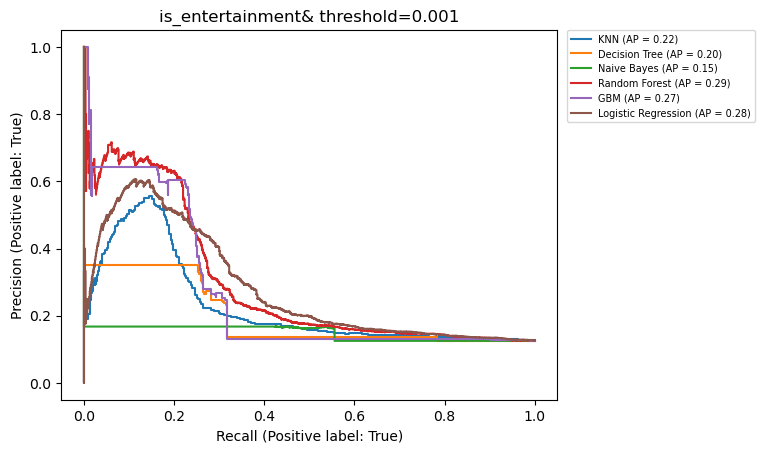

is_traffic
Fitting 3 folds for each of 800 candidates, totalling 2400 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_d98b12cd82c749dabbf72f63a22283fe/90917-140219016274992-4df638ce4dd042acaa4bad52467da1de.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_06919873577e4d9ca5a6df47f39a1068/90917-140219016274992-4df638ce4dd042acaa4bad52467da1de.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

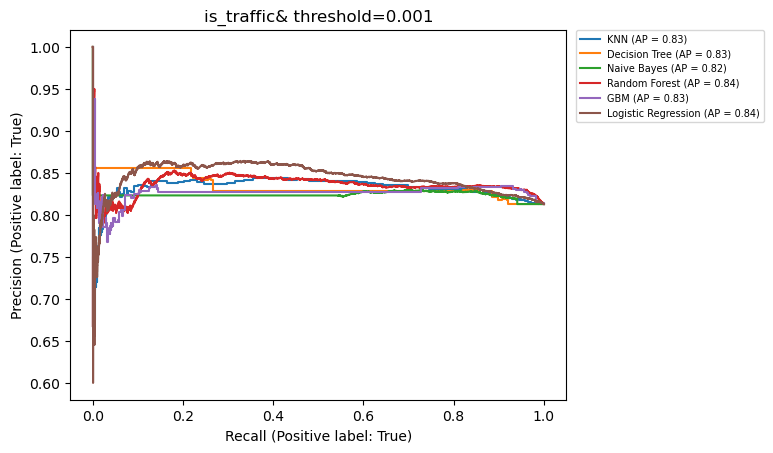

In [182]:
for j in [0,1]:
    print(label[j])
    X_train = df_wt_nmf_train_01
    X_test = df_wt_nmf_test_01
    y_train, y_test = train_test_split(labeldf[label[j]], test_size=0.2, random_state=434)
    
    # resample the data
    oversample = RandomOverSampler(sampling_strategy=0.5)    
    undersample = RandomUnderSampler(sampling_strategy=1)
    X_train, y_train = oversample.fit_resample(X_train, y_train)
    X_train, y_train = undersample.fit_resample(X_train, y_train)
    
    # create and fit the KNN model
    '''
    ## cross validation
    knn = KNeighborsClassifier()
    k_range = list(range(1, 175))
    param_grid = dict(n_neighbors=k_range)
  
    # defining parameter range
    grid = GridSearchCV(knn, param_grid, cv=3, scoring='f1', return_train_score=False,verbose=1)
  
    # fitting the model for grid search
    grid_search=grid.fit(X_train, y_train)
    best_k = list(grid_search.best_params_.values())[0]
    '''
    ## fit the best knn model
    knn_best = KNeighborsClassifier(n_neighbors=283)
    knn_best.fit(X_train, y_train)

    # create and fit Decision Tree Model
    tree_model = DecisionTreeClassifier(random_state=42)
    tree_model.fit(X_train, y_train)
    
    ## grid search CV
    params = {
    'max_depth': [20, 30, 50, 100],
    'min_samples_leaf': [2,5,10,15,20],
    'min_samples_split': [2,10,20,30,40],
    'splitter' : ['best','random'],
    'max_features' : ['sqrt','log2'],
    'criterion' : ['gini', 'entropy']
    }
    grid_search = GridSearchCV(estimator=tree_model, 
                           param_grid=params, 
                           cv=3, n_jobs=-1, verbose=1, scoring = "f1")
    
    ## fit th best decision tree model 
    grid_search.fit(X_train, y_train)
    dt_best = grid_search.best_estimator_
    
    # create and fit the Naive Bayes model
    nb_model = GaussianNB()
    nb_model.fit(X_train, y_train)
    
    ## grid search CV
    cv_method = RepeatedStratifiedKFold(n_splits=5, 
                                        n_repeats=3, 
                                        random_state=999)
    params_NB = {'var_smoothing': np.logspace(0,-9, num=100)}
    gs_NB = GridSearchCV(estimator=nb_model, 
                         param_grid=params_NB, 
                         cv=cv_method,
                         verbose=1, 
                         scoring='f1')
    
    Data_transformed = PowerTransformer().fit_transform(X_train)
    Data_transformed_test = PowerTransformer().fit_transform(X_test)

    ## fit the best naive bayes model 
    gs_NB.fit(Data_transformed, y_train)

    # create and fit Random Forest Model
    rf_01 = RandomForestClassifier(random_state=42)
    rf_01.fit(X_train, y_train)
    
    ## grid search CV
    parameters = {
        'n_estimators': [100, 250, 500], # chose these for optimal accuracy + computation time
        'max_features': ['sqrt','log2'], 
        'max_depth': [10, 20, 30]
    }
    grid_search = GridSearchCV(estimator=rf_01, 
                           param_grid=parameters, 
                           cv=3, n_jobs=-1, verbose=1, scoring = "f1")
    
    ## fit the best random forest model
    grid_search.fit(X_train, y_train)
    rf_01_best = grid_search.best_estimator_
    
    # create and fit the GBM model 
    gbm_model = GBC(n_estimators=100,learning_rate = 0.05)
    gbm_model.fit(X_train, y_train)
    
    # create and fit the Logistic Regression Model
    lr_l2 = LogisticRegression(max_iter=1000, penalty='l2')
    lr_l2.fit(X_train, y_train)
    
    """
    ## cross validation
    lr_model = LogisticRegression()
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    # define search space
    space = dict()
    space['solver'] = ['newton-cg', 'lbfgs', 'liblinear']
    space['penalty'] = ['none', 'l1', 'l2', 'elasticnet']
    space['C'] = [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10, 100]
    # define search
    search = GridSearchCV(lr_model, space, scoring='accuracy', n_jobs=-1, cv=cv)
    # execute search
    lr_best = search.fit(X_train, y_train)
    plot_precision_recall_curve(lr_best, X_test, y_test, ax = plt.gca(), name = 'Logistic Regression')
    """
    
    # precision/recall curve
    plot_precision_recall_curve(knn_best, X_test, y_test, ax = plt.gca(), name = 'KNN')
    plot_precision_recall_curve(dt_best, X_test, y_test, ax = plt.gca(), name = 'Decision Tree')
    plot_precision_recall_curve(gs_NB, Data_transformed_test, y_test, ax = plt.gca(), name = 'Naive Bayes')
    plot_precision_recall_curve(rf_01_best, X_test, y_test, ax = plt.gca(), name = 'Random Forest')
    plot_precision_recall_curve(gbm_model, X_test, y_test, ax = plt.gca(), name = 'GBM')
    plot_precision_recall_curve(lr_l2 , X_test, y_test, ax = plt.gca(), name = 'Logistic Regression')

    plt.title(label[j]+"& threshold=0.001")
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, prop={'size': 7})
    plt.show()

#### Precision-Recall Curves (threshold=0.003)

is_entertainment
Fitting 3 folds for each of 800 candidates, totalling 2400 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.03942847 0.04288307]
 ...
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_a4360379c53d4c889848ae409759149c/90917-140219016274992-5b21d98b7a6840f78e5d6cb5966c8f60.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://git

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.03942847 0.04288307]
 ...
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_ed8a47b57c0949d7b0fbdd482208767a/90917-140219016274992-5b21d98b7a6840f78e5d6cb5966c8f60.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://git

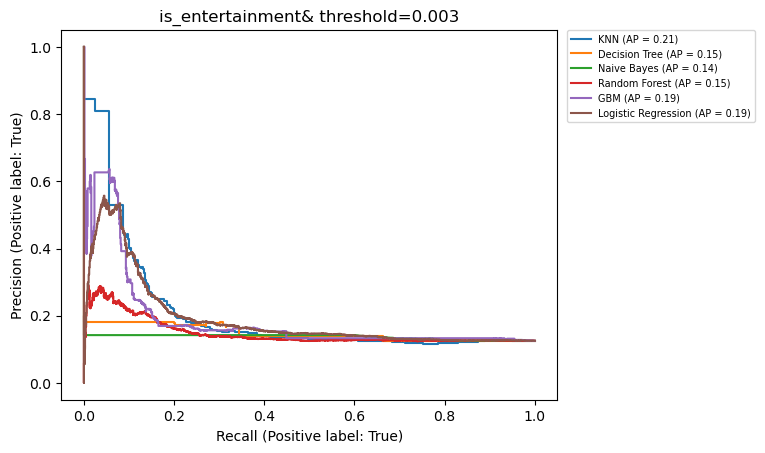

is_traffic
Fitting 3 folds for each of 800 candidates, totalling 2400 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_19c8f28ec8214c5abafb48520622a17e/90917-140219016274992-88bf2ccaff354e5689a507051d303e43.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_65b27404876e4217adc8f5b5d530fcca/90917-140219016274992-88bf2ccaff354e5689a507051d303e43.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

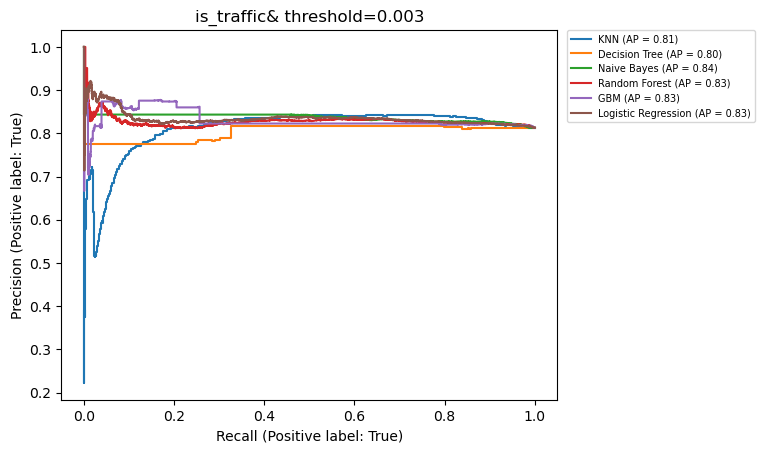

In [183]:
for j in [0,1]:
    print(label[j])
    X_train = df_wt_nmf_train_03
    X_test = df_wt_nmf_test_03
    y_train, y_test = train_test_split(labeldf[label[j]], test_size=0.2, random_state=434)
    
    # resample the data
    oversample = RandomOverSampler(sampling_strategy=0.5)    
    undersample = RandomUnderSampler(sampling_strategy=1)
    X_train, y_train = oversample.fit_resample(X_train, y_train)
    X_train, y_train = undersample.fit_resample(X_train, y_train)
    
    # create and fit the KNN model
    '''
    ## cross validation
    knn = KNeighborsClassifier()
    k_range = list(range(1, 175))
    param_grid = dict(n_neighbors=k_range)
  
    # defining parameter range
    grid = GridSearchCV(knn, param_grid, cv=3, scoring='f1', return_train_score=False,verbose=1)
  
    # fitting the model for grid search
    grid_search=grid.fit(X_train, y_train)
    best_k = list(grid_search.best_params_.values())[0]
    
    '''
    ## fit the best knn model
    knn_best = KNeighborsClassifier(n_neighbors=283)
    knn_best.fit(X_train, y_train)

    # create and fit Decision Tree Model
    tree_model = DecisionTreeClassifier(random_state=42)
    tree_model.fit(X_train, y_train)
    
    ## grid search CV
    params = {
    'max_depth': [20, 30, 50, 100],
    'min_samples_leaf': [2,5,10,15,20],
    'min_samples_split': [2,10,20,30,40],
    'splitter' : ['best','random'],
    'max_features' : ['sqrt','log2'],
    'criterion' : ['gini', 'entropy']
    }
    grid_search = GridSearchCV(estimator=tree_model, 
                           param_grid=params, 
                           cv=3, n_jobs=-1, verbose=1, scoring = "f1")
    
    ## fit th best decision tree model 
    grid_search.fit(X_train, y_train)
    dt_best = grid_search.best_estimator_
    
    # create and fit the Naive Bayes model
    nb_model = GaussianNB()
    nb_model.fit(X_train, y_train)
    
    ## grid search CV
    cv_method = RepeatedStratifiedKFold(n_splits=5, 
                                        n_repeats=3, 
                                        random_state=999)
    params_NB = {'var_smoothing': np.logspace(0,-9, num=100)}
    gs_NB = GridSearchCV(estimator=nb_model, 
                         param_grid=params_NB, 
                         cv=cv_method,
                         verbose=1, 
                         scoring='f1')
    
    Data_transformed = PowerTransformer().fit_transform(X_train)
    Data_transformed_test = PowerTransformer().fit_transform(X_test)

    ## fit the best naive bayes model 
    gs_NB.fit(Data_transformed, y_train)
    
    # create and fit Random Forest Model
    rf_01 = RandomForestClassifier(random_state=42)
    rf_01.fit(X_train, y_train)
    
    ## grid search CV
    parameters = {
        'n_estimators': [100, 250, 500], # chose these for optimal accuracy + computation time
        'max_features': ['sqrt','log2'], 
        'max_depth': [10, 20, 30]
    }
    grid_search = GridSearchCV(estimator=rf_01, 
                           param_grid=parameters, 
                           cv=3, n_jobs=-1, verbose=1, scoring = "f1")
    
    ## fit the best random forest model
    grid_search.fit(X_train, y_train)
    rf_01_best = grid_search.best_estimator_
    
    # create and fit the GBM model 
    gbm_model = GBC(n_estimators=100,learning_rate = 0.05)
    gbm_model.fit(X_train, y_train)
    
    # create and fit the Logistic Regression Model
    lr_l2 = LogisticRegression(max_iter=1000, penalty='l2')
    lr_l2.fit(X_train, y_train)
    """
    ## cross validation
    lr_model = LogisticRegression()
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    # define search space
    space = dict()
    space['solver'] = ['newton-cg', 'lbfgs', 'liblinear']
    space['penalty'] = ['none', 'l1', 'l2', 'elasticnet']
    space['C'] = [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10, 100]
    # define search
    search = GridSearchCV(lr_model, space, scoring='accuracy', n_jobs=-1, cv=cv)
    # execute search
    lr_best = search.fit(X_train, y_train)
    plot_precision_recall_curve(lr_best, X_test, y_test, ax = plt.gca(), name = 'Logistic Regression')
    """
    
    # precision/recall curve
    plot_precision_recall_curve(knn_best, X_test, y_test, ax = plt.gca(), name = 'KNN')
    plot_precision_recall_curve(dt_best, X_test, y_test, ax = plt.gca(), name = 'Decision Tree')
    plot_precision_recall_curve(gs_NB, Data_transformed_test, y_test, ax = plt.gca(), name = 'Naive Bayes')
    plot_precision_recall_curve(rf_01_best, X_test, y_test, ax = plt.gca(), name = 'Random Forest')
    plot_precision_recall_curve(gbm_model, X_test, y_test, ax = plt.gca(), name = 'GBM')
    plot_precision_recall_curve(lr_l2 , X_test, y_test, ax = plt.gca(), name = 'Logistic Regression')

    plt.title(label[j]+"& threshold=0.003")
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, prop={'size': 7})
    plt.show()

#### Precision-Recall Curves (threshold=0.005)

is_entertainment
Fitting 3 folds for each of 800 candidates, totalling 2400 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.33135849 0.        ]
 ...
 [0.         1.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_559e576ec42d420a825b1516e9538fd0/90917-140219016274992-bac29f4995de4af0ac91e44ae02b28df.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://git

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.33135849 0.        ]
 ...
 [0.         1.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_f54fd1f8460d4fd59014a71861bc5d79/90917-140219016274992-bac29f4995de4af0ac91e44ae02b28df.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://git

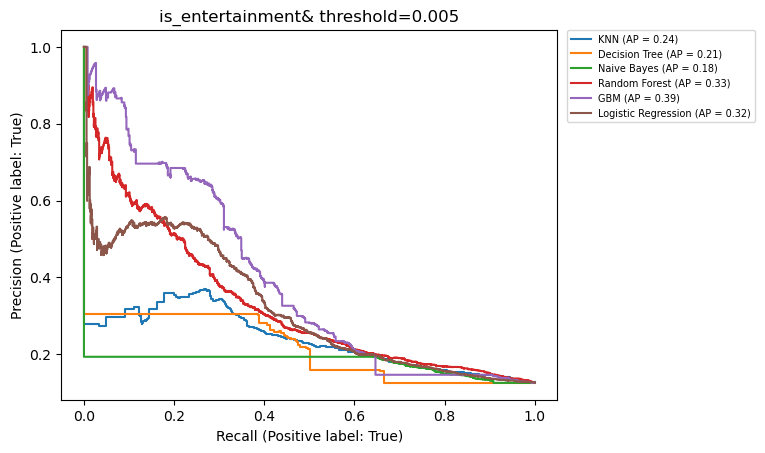

is_traffic
Fitting 3 folds for each of 800 candidates, totalling 2400 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_cb0bf9e61fff40c8854c1a7bb3b54b41/90917-140219016274992-b1e7acad4c5b4310bd4fe0b28b4ec402.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_d18f6da614434e7689ad69b5a988117e/90917-140219016274992-b1e7acad4c5b4310bd4fe0b28b4ec402.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

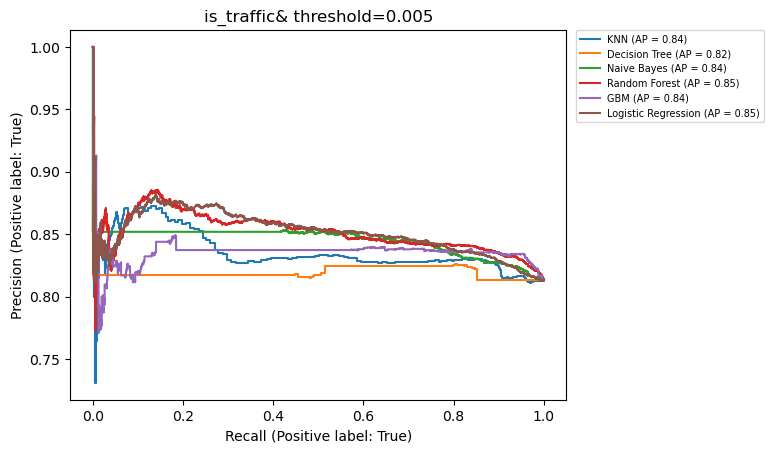

In [184]:
for j in [0,1]:
    print(label[j])
    X_train = df_wt_nmf_train_05
    X_test = df_wt_nmf_test_05
    y_train, y_test = train_test_split(labeldf[label[j]], test_size=0.2, random_state=434)
    
    # resample the data
    oversample = RandomOverSampler(sampling_strategy=0.5)    
    undersample = RandomUnderSampler(sampling_strategy=1)
    X_train, y_train = oversample.fit_resample(X_train, y_train)
    X_train, y_train = undersample.fit_resample(X_train, y_train)
    
    # create and fit the KNN model
    """
    ## cross validation
    knn = KNeighborsClassifier()
    k_range = list(range(1, 175))
    param_grid = dict(n_neighbors=k_range)
  
    # defining parameter range
    grid = GridSearchCV(knn, param_grid, cv=3, scoring='f1', return_train_score=False,verbose=1)
  
    # fitting the model for grid search
    grid_search=grid.fit(X_train, y_train)
    best_k = list(grid_search.best_params_.values())[0]
    """
    
    ## fit the best knn model
    knn_best = KNeighborsClassifier(n_neighbors=283)
    knn_best.fit(X_train, y_train)

    # create and fit Decision Tree Model
    tree_model = DecisionTreeClassifier(random_state=42)
    tree_model.fit(X_train, y_train)
    
    ## grid search CV
    params = {
    'max_depth': [20, 30, 50, 100],
    'min_samples_leaf': [2,5,10,15,20],
    'min_samples_split': [2,10,20,30,40],
    'splitter' : ['best','random'],
    'max_features' : ['sqrt','log2'],
    'criterion' : ['gini', 'entropy']
    }
    grid_search = GridSearchCV(estimator=tree_model, 
                           param_grid=params, 
                           cv=3, n_jobs=-1, verbose=1, scoring = "f1")
    
    ## fit th best decision tree model 
    grid_search.fit(X_train, y_train)
    dt_best = grid_search.best_estimator_
    
    # create and fit the Naive Bayes model
    nb_model = GaussianNB()
    nb_model.fit(X_train, y_train)
    
    ## grid search CV
    cv_method = RepeatedStratifiedKFold(n_splits=5, 
                                        n_repeats=3, 
                                        random_state=999)
    params_NB = {'var_smoothing': np.logspace(0,-9, num=100)}
    gs_NB = GridSearchCV(estimator=nb_model, 
                         param_grid=params_NB, 
                         cv=cv_method,
                         verbose=1, 
                         scoring='f1')
    
    Data_transformed = PowerTransformer().fit_transform(X_train)
    Data_transformed_test = PowerTransformer().fit_transform(X_test)

    ## fit the best naive bayes model 
    gs_NB.fit(Data_transformed, y_train)

    # create and fit Random Forest Model
    rf_01 = RandomForestClassifier(random_state=42)
    rf_01.fit(X_train, y_train)
    
    ## grid search CV
    parameters = {
        'n_estimators': [100, 250, 500], # chose these for optimal accuracy + computation time
        'max_features': ['sqrt','log2'], 
        'max_depth': [10, 20, 30]
    }
    grid_search = GridSearchCV(estimator=rf_01, 
                           param_grid=parameters, 
                           cv=3, n_jobs=-1, verbose=1, scoring = "f1")
    
    ## fit the best random forest model
    grid_search.fit(X_train, y_train)
    rf_01_best = grid_search.best_estimator_
    
    # create and fit the GBM model 
    gbm_model = GBC(n_estimators=100,learning_rate = 0.05)
    gbm_model.fit(X_train, y_train)
    
    # create and fit the Logistic Regression Model
    lr_l2 = LogisticRegression(max_iter=1000, penalty='l2')
    lr_l2.fit(X_train, y_train)
    """
    ## cross validation
    lr_model = LogisticRegression()
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    # define search space
    space = dict()
    space['solver'] = ['newton-cg', 'lbfgs', 'liblinear']
    space['penalty'] = ['none', 'l1', 'l2', 'elasticnet']
    space['C'] = [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10, 100]
    # define search
    search = GridSearchCV(lr_model, space, scoring='accuracy', n_jobs=-1, cv=cv)
    # execute search
    lr_best = search.fit(X_train, y_train)
    plot_precision_recall_curve(lr_best, X_test, y_test, ax = plt.gca(), name = 'Logistic Regression')
    """
    
    # precision/recall curve
    plot_precision_recall_curve(knn_best, X_test, y_test, ax = plt.gca(), name = 'KNN')
    plot_precision_recall_curve(dt_best, X_test, y_test, ax = plt.gca(), name = 'Decision Tree')
    plot_precision_recall_curve(gs_NB, Data_transformed_test, y_test, ax = plt.gca(), name = 'Naive Bayes')
    plot_precision_recall_curve(rf_01_best, X_test, y_test, ax = plt.gca(), name = 'Random Forest')
    plot_precision_recall_curve(gbm_model, X_test, y_test, ax = plt.gca(), name = 'GBM')
    plot_precision_recall_curve(lr_l2 , X_test, y_test, ax = plt.gca(), name = 'Logistic Regression')

    plt.title(label[j]+"& threshold=0.005")
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, prop={'size': 7})
    plt.show()

#### Precision-Recall Curves (threshold=0.01)

is_entertainment
Fitting 3 folds for each of 800 candidates, totalling 2400 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_b6ff722c54a64c18a5cd495351f0670e/90917-140219016274992-5466c63986fa42588d6a7f299451fc1f.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [1.

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_af20b6af8bc8476eb5d2fcca9663d994/90917-140219016274992-5466c63986fa42588d6a7f299451fc1f.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [1.

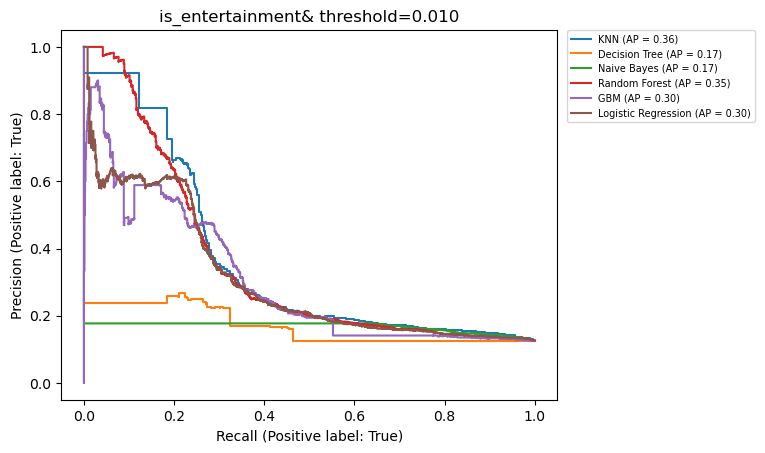

is_traffic
Fitting 3 folds for each of 800 candidates, totalling 2400 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_b383e06d1b4849d297ba4433b9e3f7a0/90917-140219016274992-e96ce419cd7f4d1a948d6dcac4d254e7.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_25d05a137d5547d7916048e8af908f6a/90917-140219016274992-e96ce419cd7f4d1a948d6dcac4d254e7.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

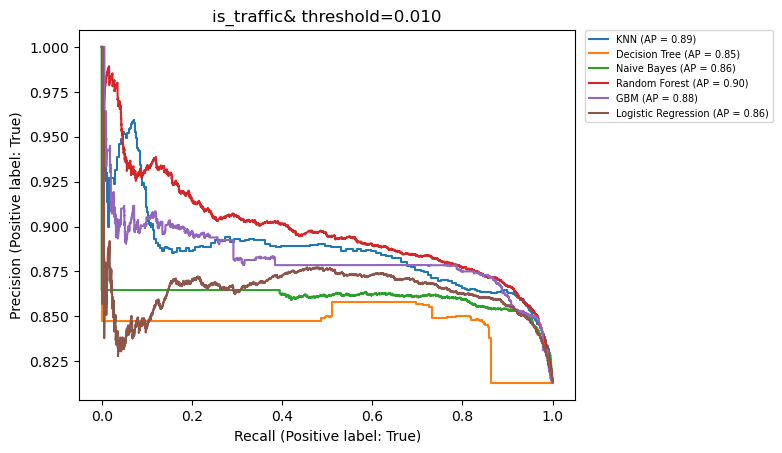

In [185]:
for j in [0,1]:
    print(label[j])
    X_train = df_wt_nmf_train_10
    X_test = df_wt_nmf_test_10
    y_train, y_test = train_test_split(labeldf[label[j]], test_size=0.2, random_state=434)
    
    # resample the data
    oversample = RandomOverSampler(sampling_strategy=0.5)    
    undersample = RandomUnderSampler(sampling_strategy=1)
    X_train, y_train = oversample.fit_resample(X_train, y_train)
    X_train, y_train = undersample.fit_resample(X_train, y_train)
    
    # create and fit the KNN model
    '''
    ## cross validation
    knn = KNeighborsClassifier()
    k_range = list(range(1, 175))
    param_grid = dict(n_neighbors=k_range)
  
    # defining parameter range
    grid = GridSearchCV(knn, param_grid, cv=3, scoring='f1', return_train_score=False,verbose=1)
  
    # fitting the model for grid search
    grid_search=grid.fit(X_train, y_train)
    best_k = list(grid_search.best_params_.values())[0]
    '''
    ## fit the best knn model
    knn_best = KNeighborsClassifier(n_neighbors=283)
    knn_best.fit(X_train, y_train)

    # create and fit Decision Tree Model
    tree_model = DecisionTreeClassifier(random_state=42)
    tree_model.fit(X_train, y_train)
    
    ## grid search CV
    params = {
    'max_depth': [20, 30, 50, 100],
    'min_samples_leaf': [2,5,10,15,20],
    'min_samples_split': [2,10,20,30,40],
    'splitter' : ['best','random'],
    'max_features' : ['sqrt','log2'],
    'criterion' : ['gini', 'entropy']
    }
    grid_search = GridSearchCV(estimator=tree_model, 
                           param_grid=params, 
                           cv=3, n_jobs=-1, verbose=1, scoring = "f1")
    
    ## fit th best decision tree model 
    grid_search.fit(X_train, y_train)
    dt_best = grid_search.best_estimator_
    
    # create and fit the Naive Bayes model
    nb_model = GaussianNB()
    nb_model.fit(X_train, y_train)
    
    ## grid search CV
    cv_method = RepeatedStratifiedKFold(n_splits=5, 
                                        n_repeats=3, 
                                        random_state=999)
    params_NB = {'var_smoothing': np.logspace(0,-9, num=100)}
    gs_NB = GridSearchCV(estimator=nb_model, 
                         param_grid=params_NB, 
                         cv=cv_method,
                         verbose=1, 
                         scoring='f1')
    
    Data_transformed = PowerTransformer().fit_transform(X_train)
    Data_transformed_test = PowerTransformer().fit_transform(X_test)

    ## fit the best naive bayes model 
    gs_NB.fit(Data_transformed, y_train)

    # create and fit Random Forest Model
    rf_01 = RandomForestClassifier(random_state=42)
    rf_01.fit(X_train, y_train)
    
    ## grid search CV
    parameters = {
        'n_estimators': [100, 250, 500], # chose these for optimal accuracy + computation time
        'max_features': ['sqrt','log2'], 
        'max_depth': [10, 20, 30]
    }
    grid_search = GridSearchCV(estimator=rf_01, 
                           param_grid=parameters, 
                           cv=3, n_jobs=-1, verbose=1, scoring = "f1")
    
    ## fit the best random forest model
    grid_search.fit(X_train, y_train)
    rf_01_best = grid_search.best_estimator_
    
    # create and fit the GBM model 
    gbm_model = GBC(n_estimators=100,learning_rate = 0.05)
    gbm_model.fit(X_train, y_train)
    
    # create and fit the Logistic Regression Model
    lr_l2 = LogisticRegression(max_iter=1000, penalty='l2')
    lr_l2.fit(X_train, y_train)
    """
    ## cross validation
    lr_model = LogisticRegression()
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    # define search space
    space = dict()
    space['solver'] = ['newton-cg', 'lbfgs', 'liblinear']
    space['penalty'] = ['none', 'l1', 'l2', 'elasticnet']
    space['C'] = [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10, 100]
    # define search
    search = GridSearchCV(lr_model, space, scoring='accuracy', n_jobs=-1, cv=cv)
    # execute search
    lr_best = search.fit(X_train, y_train)
    plot_precision_recall_curve(lr_best, X_test, y_test, ax = plt.gca(), name = 'Logistic Regression')
    """
    
    # precision/recall curve
    plot_precision_recall_curve(knn_best, X_test, y_test, ax = plt.gca(), name = 'KNN')
    plot_precision_recall_curve(dt_best, X_test, y_test, ax = plt.gca(), name = 'Decision Tree')
    plot_precision_recall_curve(gs_NB, Data_transformed_test, y_test, ax = plt.gca(), name = 'Naive Bayes')
    plot_precision_recall_curve(rf_01_best, X_test, y_test, ax = plt.gca(), name = 'Random Forest')
    plot_precision_recall_curve(gbm_model, X_test, y_test, ax = plt.gca(), name = 'GBM')
    plot_precision_recall_curve(lr_l2 , X_test, y_test, ax = plt.gca(), name = 'Logistic Regression')

    plt.title(label[j]+"& threshold=0.010")
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, prop={'size': 7})
    plt.show()

#### Precision-Recall Curves (threshold=0.015)

is_entertainment
Fitting 3 folds for each of 800 candidates, totalling 2400 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 1. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_54d8d51d4f184fe485bb70019b663ca7/90917-140219016274992-d2ee7e0aba4e4035b81986e52583a986.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 1. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 1. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_ec3733b2f84a42af8b53ce40d5ca83db/90917-140219016274992-d2ee7e0aba4e4035b81986e52583a986.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 1. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

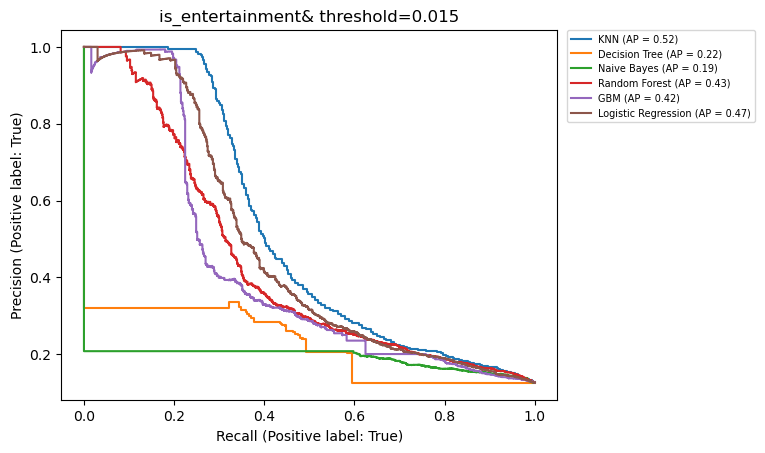

is_traffic
Fitting 3 folds for each of 800 candidates, totalling 2400 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_3a0702987dc34580b37cb2c4563b19bd/90917-140219016274992-08245261abbc49c4bb26d97d10be0b88.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_0ca049f0b3c642f78996be22793a649c/90917-140219016274992-08245261abbc49c4bb26d97d10be0b88.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://github.com/joblib/joblib/issues/563 for more details
  warnings.warn(message)
/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [1. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0.

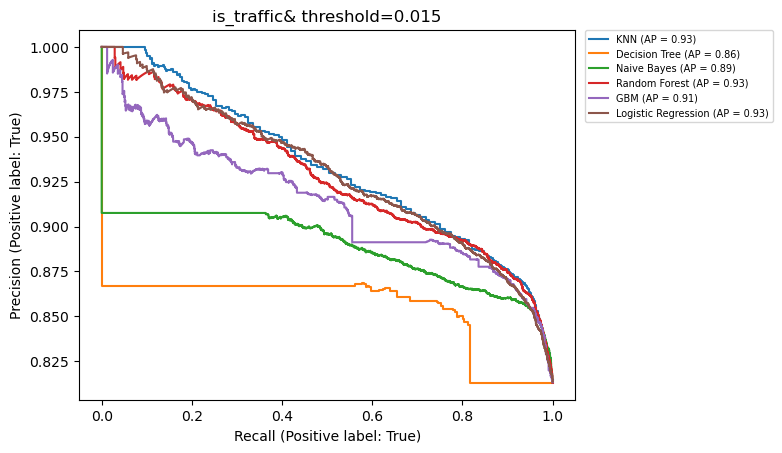

In [186]:
for j in [0,1]:
    print(label[j])
    X_train = df_wt_nmf_train_15
    X_test = df_wt_nmf_test_15
    y_train, y_test = train_test_split(labeldf[label[j]], test_size=0.2, random_state=434)
    
    # resample the data
    oversample = RandomOverSampler(sampling_strategy=0.5)    
    undersample = RandomUnderSampler(sampling_strategy=1)
    X_train, y_train = oversample.fit_resample(X_train, y_train)
    X_train, y_train = undersample.fit_resample(X_train, y_train)
    
    # create and fit the KNN model
    '''
    ## cross validation
    knn = KNeighborsClassifier()
    k_range = list(range(1, 175))
    param_grid = dict(n_neighbors=k_range)
  
    # defining parameter range
    grid = GridSearchCV(knn, param_grid, cv=3, scoring='f1', return_train_score=False,verbose=1)
  
    # fitting the model for grid search
    grid_search=grid.fit(X_train, y_train)
    best_k = list(grid_search.best_params_.values())[0]
    '''
    ## fit the best knn model
    knn_best = KNeighborsClassifier(n_neighbors=283)
    knn_best.fit(X_train, y_train)

    # create and fit Decision Tree Model
    tree_model = DecisionTreeClassifier(random_state=42)
    tree_model.fit(X_train, y_train)
    
    ## grid search CV
    params = {
    'max_depth': [20, 30, 50, 100],
    'min_samples_leaf': [2,5,10,15,20],
    'min_samples_split': [2,10,20,30,40],
    'splitter' : ['best','random'],
    'max_features' : ['sqrt','log2'],
    'criterion' : ['gini', 'entropy']
    }
    grid_search = GridSearchCV(estimator=tree_model, 
                           param_grid=params, 
                           cv=3, n_jobs=-1, verbose=1, scoring = "f1")
    
    ## fit th best decision tree model 
    grid_search.fit(X_train, y_train)
    dt_best = grid_search.best_estimator_
    
    # create and fit the Naive Bayes model
    nb_model = GaussianNB()
    nb_model.fit(X_train, y_train)
    
    ## grid search CV
    cv_method = RepeatedStratifiedKFold(n_splits=5, 
                                        n_repeats=3, 
                                        random_state=999)
    params_NB = {'var_smoothing': np.logspace(0,-9, num=100)}
    gs_NB = GridSearchCV(estimator=nb_model, 
                         param_grid=params_NB, 
                         cv=cv_method,
                         verbose=1, 
                         scoring='f1')
    
    Data_transformed = PowerTransformer().fit_transform(X_train)
    Data_transformed_test = PowerTransformer().fit_transform(X_test)

    ## fit the best naive bayes model 
    gs_NB.fit(Data_transformed, y_train)
    
    # create and fit Random Forest Model
    rf_01 = RandomForestClassifier(random_state=42)
    rf_01.fit(X_train, y_train)
    
    ## grid search CV
    parameters = {
        'n_estimators': [100, 250, 500], # chose these for optimal accuracy + computation time
        'max_features': ['sqrt','log2'], 
        'max_depth': [10, 20, 30]
    }
    grid_search = GridSearchCV(estimator=rf_01, 
                           param_grid=parameters, 
                           cv=3, n_jobs=-1, verbose=1, scoring = "f1")
    
    ## fit the best random forest model
    grid_search.fit(X_train, y_train)
    rf_01_best = grid_search.best_estimator_
    
    # create and fit the GBM model 
    gbm_model = GBC(n_estimators=100,learning_rate = 0.05)
    gbm_model.fit(X_train, y_train)
    
    # create and fit the Logistic Regression Model
    lr_l2 = LogisticRegression(max_iter=1000, penalty='l2')
    lr_l2.fit(X_train, y_train)
    """
    ## cross validation
    lr_model = LogisticRegression()
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    # define search space
    space = dict()
    space['solver'] = ['newton-cg', 'lbfgs', 'liblinear']
    space['penalty'] = ['none', 'l1', 'l2', 'elasticnet']
    space['C'] = [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10, 100]
    # define search
    search = GridSearchCV(lr_model, space, scoring='accuracy', n_jobs=-1, cv=cv)
    # execute search
    lr_best = search.fit(X_train, y_train)
    plot_precision_recall_curve(lr_best, X_test, y_test, ax = plt.gca(), name = 'Logistic Regression')
    """
    
    # precision/recall curve
    plot_precision_recall_curve(knn_best, X_test, y_test, ax = plt.gca(), name = 'KNN')
    plot_precision_recall_curve(dt_best, X_test, y_test, ax = plt.gca(), name = 'Decision Tree')
    plot_precision_recall_curve(gs_NB, Data_transformed_test, y_test, ax = plt.gca(), name = 'Naive Bayes')
    plot_precision_recall_curve(rf_01_best, X_test, y_test, ax = plt.gca(), name = 'Random Forest')
    plot_precision_recall_curve(gbm_model, X_test, y_test, ax = plt.gca(), name = 'GBM')
    plot_precision_recall_curve(lr_l2 , X_test, y_test, ax = plt.gca(), name = 'Logistic Regression')

    plt.title(label[j]+"& threshold=0.015")
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, prop={'size': 7})
    plt.show()

#### Precision-Recall Curves (threshold=0.020)

is_entertainment
Fitting 3 folds for each of 800 candidates, totalling 2400 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0.         0.         0.         ... 0.10233353 0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.05979574 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.08986218 0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.12857694]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_f7b75b76d1614cbabf3f97f7705e2849/90917-140219016274992-7a1d4b18d59940cdb8fa338fe36bcf6d.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://git

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0.         0.         0.         ... 0.10233353 0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.05979574 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.08986218 0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.12857694]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_a4d027d92b994564b139a707d0cd5ee5/90917-140219016274992-7a1d4b18d59940cdb8fa338fe36bcf6d.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://git

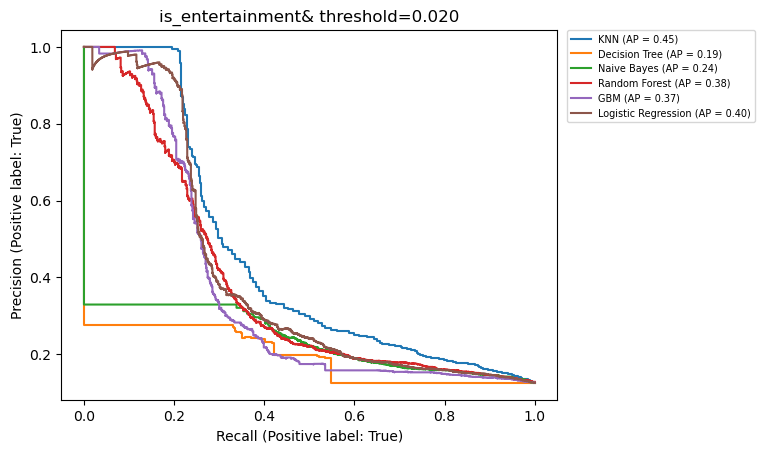

is_traffic
Fitting 3 folds for each of 800 candidates, totalling 2400 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [1.         0.         0.         ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 0.         0.         0.15895346]
 [0.         0.         0.         ... 0.2568646  0.         0.        ]
 [0.         1.         0.         ... 0.         0.         0.        ]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_b37b9d3fc3cf4ba6be4212b1495465cc/90917-140219016274992-adfa5d2e714f4c9fb109642e56a44768.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://git

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [1.         0.         0.         ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 0.         0.         0.15895346]
 [0.         0.         0.         ... 0.2568646  0.         0.        ]
 [0.         1.         0.         ... 0.         0.         0.        ]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_23c92a116bef40cbab1a6d835df0a562/90917-140219016274992-adfa5d2e714f4c9fb109642e56a44768.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://git

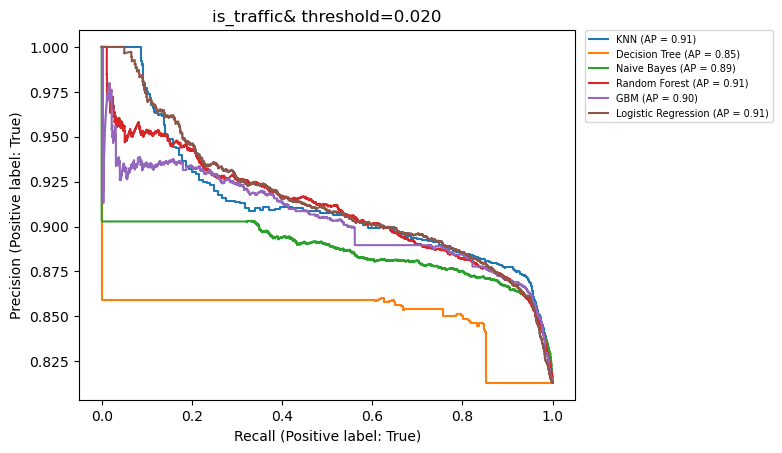

In [187]:
for j in [0,1]:
    print(label[j])
    X_train = df_wt_nmf_train_20
    X_test = df_wt_nmf_test_20
    y_train, y_test = train_test_split(labeldf[label[j]], test_size=0.2, random_state=434)
    
    # resample the data
    oversample = RandomOverSampler(sampling_strategy=0.5)    
    undersample = RandomUnderSampler(sampling_strategy=1)
    X_train, y_train = oversample.fit_resample(X_train, y_train)
    X_train, y_train = undersample.fit_resample(X_train, y_train)
    
    # create and fit the KNN model
    '''
    ## cross validation
    knn = KNeighborsClassifier()
    k_range = list(range(1, 175))
    param_grid = dict(n_neighbors=k_range)
  
    # defining parameter range
    grid = GridSearchCV(knn, param_grid, cv=3, scoring='f1', return_train_score=False,verbose=1)
  
    # fitting the model for grid search
    grid_search=grid.fit(X_train, y_train)
    best_k = list(grid_search.best_params_.values())[0]
    '''
    ## fit the best knn model
    knn_best = KNeighborsClassifier(n_neighbors=283)
    knn_best.fit(X_train, y_train)

    # create and fit Decision Tree Model
    tree_model = DecisionTreeClassifier(random_state=42)
    tree_model.fit(X_train, y_train)
    
    ## grid search CV
    params = {
    'max_depth': [20, 30, 50, 100],
    'min_samples_leaf': [2,5,10,15,20],
    'min_samples_split': [2,10,20,30,40],
    'splitter' : ['best','random'],
    'max_features' : ['sqrt','log2'],
    'criterion' : ['gini', 'entropy']
    }
    grid_search = GridSearchCV(estimator=tree_model, 
                           param_grid=params, 
                           cv=3, n_jobs=-1, verbose=1, scoring = "f1")
    
    ## fit th best decision tree model 
    grid_search.fit(X_train, y_train)
    dt_best = grid_search.best_estimator_
    
    # create and fit the Naive Bayes model
    nb_model = GaussianNB()
    nb_model.fit(X_train, y_train)
    
    ## grid search CV
    cv_method = RepeatedStratifiedKFold(n_splits=5, 
                                        n_repeats=3, 
                                        random_state=999)
    params_NB = {'var_smoothing': np.logspace(0,-9, num=100)}
    gs_NB = GridSearchCV(estimator=nb_model, 
                         param_grid=params_NB, 
                         cv=cv_method,
                         verbose=1, 
                         scoring='f1')
    
    Data_transformed = PowerTransformer().fit_transform(X_train)
    Data_transformed_test = PowerTransformer().fit_transform(X_test)

    ## fit the best naive bayes model 
    gs_NB.fit(Data_transformed, y_train)

    # create and fit Random Forest Model
    rf_01 = RandomForestClassifier(random_state=42)
    rf_01.fit(X_train, y_train)
    
    ## grid search CV
    parameters = {
        'n_estimators': [100, 250, 500], # chose these for optimal accuracy + computation time
        'max_features': ['sqrt','log2'], 
        'max_depth': [10, 20, 30]
    }
    grid_search = GridSearchCV(estimator=rf_01, 
                           param_grid=parameters, 
                           cv=3, n_jobs=-1, verbose=1, scoring = "f1")
    
    ## fit the best random forest model
    grid_search.fit(X_train, y_train)
    rf_01_best = grid_search.best_estimator_
    
    # create and fit the GBM model 
    gbm_model = GBC(n_estimators=100,learning_rate = 0.05)
    gbm_model.fit(X_train, y_train)
    
    # create and fit the Logistic Regression Model
    lr_l2 = LogisticRegression(max_iter=1000, penalty='l2')
    lr_l2.fit(X_train, y_train)
    """
    ## cross validation
    lr_model = LogisticRegression()
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    # define search space
    space = dict()
    space['solver'] = ['newton-cg', 'lbfgs', 'liblinear']
    space['penalty'] = ['none', 'l1', 'l2', 'elasticnet']
    space['C'] = [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10, 100]
    # define search
    search = GridSearchCV(lr_model, space, scoring='accuracy', n_jobs=-1, cv=cv)
    # execute search
    lr_best = search.fit(X_train, y_train)
    plot_precision_recall_curve(lr_best, X_test, y_test, ax = plt.gca(), name = 'Logistic Regression')
    """
    
    # precision/recall curve
    plot_precision_recall_curve(knn_best, X_test, y_test, ax = plt.gca(), name = 'KNN')
    plot_precision_recall_curve(dt_best, X_test, y_test, ax = plt.gca(), name = 'Decision Tree')
    plot_precision_recall_curve(gs_NB, Data_transformed_test, y_test, ax = plt.gca(), name = 'Naive Bayes')
    plot_precision_recall_curve(rf_01_best, X_test, y_test, ax = plt.gca(), name = 'Random Forest')
    plot_precision_recall_curve(gbm_model, X_test, y_test, ax = plt.gca(), name = 'GBM')
    plot_precision_recall_curve(lr_l2 , X_test, y_test, ax = plt.gca(), name = 'Logistic Regression')

    plt.title(label[j]+"& threshold=0.020")
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, prop={'size': 7})
    plt.show()

#### Precision-Recall Curves (threshold=0.025)

is_entertainment
Fitting 3 folds for each of 800 candidates, totalling 2400 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0.         0.         0.         ... 0.         0.06379941 0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.04855573 0.06434388 0.        ]
 ...
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_d15b8b1c58804953bd2235e2584e2afc/90917-140219016274992-4e8603b6fcaf4043b4d56def0f6f7dc9.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://git

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0.         0.         0.         ... 0.         0.06379941 0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.04855573 0.06434388 0.        ]
 ...
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_ca8e6199616d421ea17b0a01fdc8cc99/90917-140219016274992-4e8603b6fcaf4043b4d56def0f6f7dc9.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://git

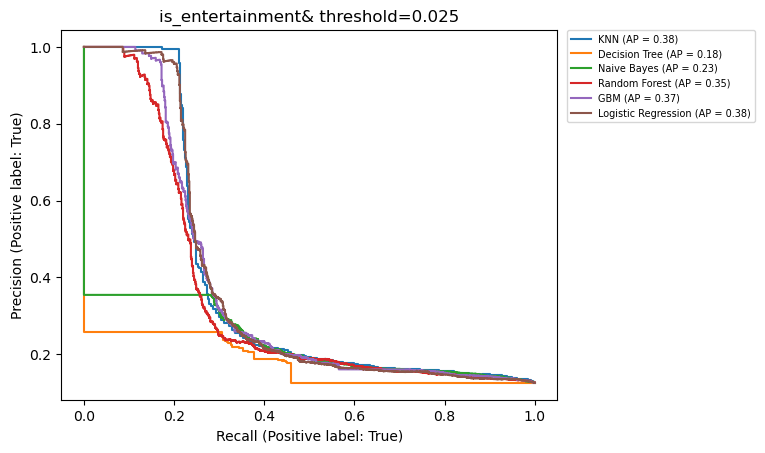

is_traffic
Fitting 3 folds for each of 800 candidates, totalling 2400 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 0.         0.04726177 0.05941716]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_1dc72594711942bc9b33cf12d646512c/90917-140219016274992-8d32d8b2197c4467a92f1236fffb0465.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://git

Fitting 15 folds for each of 100 candidates, totalling 1500 fits
Fitting 3 folds for each of 18 candidates, totalling 54 fits


/opt/anaconda3/lib/python3.8/site-packages/joblib/numpy_pickle.py:230: UserWarning: The memmapped array [[0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 0.         0.04726177 0.05941716]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]] loaded from the file /var/folders/b9/hjwyjp4x1k56ymrfvjwxfkyc0000gn/T/joblib_memmapping_folder_90917_ba050172197342aca6eb8625a722d28b_8dccf3307e574bb9bf72a732bc826511/90917-140219016274992-8d32d8b2197c4467a92f1236fffb0465.pkl is not not bytes aligned. This may cause segmentation faults if this memmapped array is used in some libraries like BLAS or PyTorch. To get rid of this warning, regenerate your pickle file with joblib >= 1.2.0. See https://git

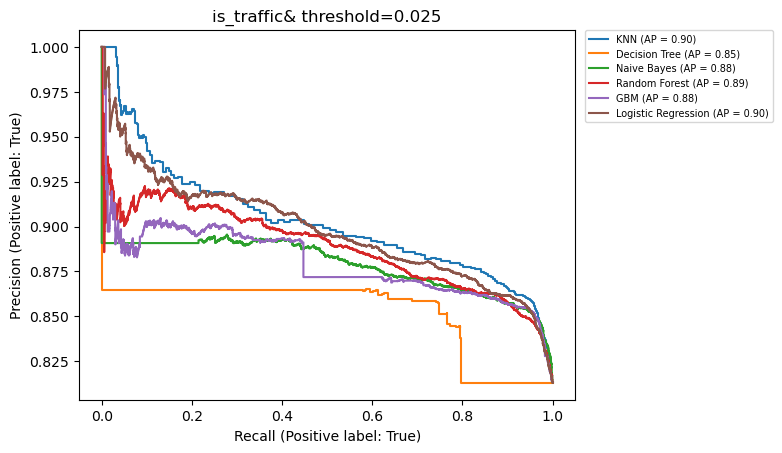

In [188]:
for j in [0,1]:
    print(label[j])
    X_train = df_wt_nmf_train_25
    X_test = df_wt_nmf_test_25
    y_train, y_test = train_test_split(labeldf[label[j]], test_size=0.2, random_state=434)
    
    # resample the data
    oversample = RandomOverSampler(sampling_strategy=0.5)    
    undersample = RandomUnderSampler(sampling_strategy=1)
    X_train, y_train = oversample.fit_resample(X_train, y_train)
    X_train, y_train = undersample.fit_resample(X_train, y_train)
    
    # create and fit the KNN model
    '''
    ## cross validation
    knn = KNeighborsClassifier()
    k_range = list(range(1, 175))
    param_grid = dict(n_neighbors=k_range)
  
    # defining parameter range
    grid = GridSearchCV(knn, param_grid, cv=3, scoring='f1', return_train_score=False,verbose=1)
  
    # fitting the model for grid search
    grid_search=grid.fit(X_train, y_train)
    best_k = list(grid_search.best_params_.values())[0]
    '''
    ## fit the best knn model
    knn_best = KNeighborsClassifier(n_neighbors=283)
    knn_best.fit(X_train, y_train)

    # create and fit Decision Tree Model
    tree_model = DecisionTreeClassifier(random_state=42)
    tree_model.fit(X_train, y_train)
    
    ## grid search CV
    params = {
    'max_depth': [20, 30, 50, 100],
    'min_samples_leaf': [2,5,10,15,20],
    'min_samples_split': [2,10,20,30,40],
    'splitter' : ['best','random'],
    'max_features' : ['sqrt','log2'],
    'criterion' : ['gini', 'entropy']
    }
    grid_search = GridSearchCV(estimator=tree_model, 
                           param_grid=params, 
                           cv=3, n_jobs=-1, verbose=1, scoring = "f1")
    
    ## fit th best decision tree model 
    grid_search.fit(X_train, y_train)
    dt_best = grid_search.best_estimator_
    
    # create and fit the Naive Bayes model
    nb_model = GaussianNB()
    nb_model.fit(X_train, y_train)
    
    ## grid search CV
    cv_method = RepeatedStratifiedKFold(n_splits=5, 
                                        n_repeats=3, 
                                        random_state=999)
    params_NB = {'var_smoothing': np.logspace(0,-9, num=100)}
    gs_NB = GridSearchCV(estimator=nb_model, 
                         param_grid=params_NB, 
                         cv=cv_method,
                         verbose=1, 
                         scoring='f1')
    Data_transformed = PowerTransformer().fit_transform(X_train)
    Data_transformed_test = PowerTransformer().fit_transform(X_test)

    ## fit the best naive bayes model 
    gs_NB.fit(Data_transformed, y_train)

    # create and fit Random Forest Model
    rf_01 = RandomForestClassifier(random_state=42)
    rf_01.fit(X_train, y_train)
    
    ## grid search CV
    parameters = {
        'n_estimators': [100, 250, 500], # chose these for optimal accuracy + computation time
        'max_features': ['sqrt','log2'], 
        'max_depth': [10, 20, 30]
    }
    grid_search = GridSearchCV(estimator=rf_01, 
                           param_grid=parameters, 
                           cv=3, n_jobs=-1, verbose=1, scoring = "f1")
    
    ## fit the best random forest model
    grid_search.fit(X_train, y_train)
    rf_01_best = grid_search.best_estimator_
    
    # create and fit the GBM model 
    gbm_model = GBC(n_estimators=100,learning_rate = 0.05)
    gbm_model.fit(X_train, y_train)
    
    # create and fit the Logistic Regression Model
    lr_l2 = LogisticRegression(max_iter=1000, penalty='l2')
    lr_l2.fit(X_train, y_train)
    """
    ## cross validation
    lr_model = LogisticRegression()
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    # define search space
    space = dict()
    space['solver'] = ['newton-cg', 'lbfgs', 'liblinear']
    space['penalty'] = ['none', 'l1', 'l2', 'elasticnet']
    space['C'] = [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10, 100]
    # define search
    search = GridSearchCV(lr_model, space, scoring='accuracy', n_jobs=-1, cv=cv)
    # execute search
    lr_best = search.fit(X_train, y_train)
    plot_precision_recall_curve(lr_best, X_test, y_test, ax = plt.gca(), name = 'Logistic Regression')
    """
    
    # precision/recall curve
    plot_precision_recall_curve(knn_best, X_test, y_test, ax = plt.gca(), name = 'KNN')
    plot_precision_recall_curve(dt_best, X_test, y_test, ax = plt.gca(), name = 'Decision Tree')
    plot_precision_recall_curve(gs_NB, Data_transformed_test, y_test, ax = plt.gca(), name = 'Naive Bayes')
    plot_precision_recall_curve(rf_01_best, X_test, y_test, ax = plt.gca(), name = 'Random Forest')
    plot_precision_recall_curve(gbm_model, X_test, y_test, ax = plt.gca(), name = 'GBM')
    plot_precision_recall_curve(lr_l2 , X_test, y_test, ax = plt.gca(), name = 'Logistic Regression')

    plt.title(label[j]+"& threshold=0.025")
    plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0, prop={'size': 7})
    plt.show()